In [5]:
import sys
sys.executable

'/home/ksmehrab/.conda/envs/rgdino/bin/python3'

In [6]:
# Increase the output cell limit
from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "last_expr"  
from IPython.display import display

In [7]:
import os
os.environ['HF_HOME'] = '/home/ksmehrab/.cache/huggingface'
os.environ['TRANSFORMERS_CACHE'] = '/home/ksmehrab/.cache/huggingface'
os.environ['TORCH_HOME'] = '/home/ksmehrab/.cache/torch'

In [8]:
import numpy as np
import torch
from huggingface_hub import hf_hub_download
from segment_anything import sam_model_registry
from segment_anything import SamPredictor, SamAutomaticMaskGenerator

/home/ksmehrab/.conda/envs/rgdino/lib/python3.9/site-packages/transformers/utils/hub.py:124: FutureWarning: Using `TRANSFORMERS_CACHE` is deprecated and will be removed in v5 of Transformers. Use `HF_HOME` instead.
  warnings.warn(


In [9]:
SAM_MODELS = {
    "vit_h": "https://dl.fbaipublicfiles.com/segment_anything/sam_vit_h_4b8939.pth",
    "vit_l": "https://dl.fbaipublicfiles.com/segment_anything/sam_vit_l_0b3195.pth",
    "vit_b": "https://dl.fbaipublicfiles.com/segment_anything/sam_vit_b_01ec64.pth"
}

CACHE_PATH = os.environ.get("TORCH_HOME", os.path.expanduser("~/.cache/torch/hub/checkpoints"))

In [10]:
class SAM_Bbox():
    def __init__(self, cuda_device=0, sam_type="vit_h", ckpt_path=None):
        self.sam_type = sam_type
        self.device = torch.device(f"cuda:{cuda_device}" if torch.cuda.is_available() else "cpu")
        self.build_sam(ckpt_path)
        # self.build_sam_automatic(ckpt_path)

    def build_sam(self, ckpt_path):
        if self.sam_type is None or ckpt_path is None:
            if self.sam_type is None:
                print("No sam type indicated. Using vit_h by default.")
                self.sam_type = "vit_h"
            checkpoint_url = SAM_MODELS[self.sam_type]
            try:
                sam = sam_model_registry[self.sam_type]()
                state_dict = torch.hub.load_state_dict_from_url(checkpoint_url)
                sam.load_state_dict(state_dict, strict=True)
            except:
                raise ValueError(f"Problem loading SAM please make sure you have the right model type: {self.sam_type} \
                    and a working checkpoint: {checkpoint_url}. Recommend deleting the checkpoint and \
                    re-downloading it.")
            sam.to(device=self.device)
            self.sam = SamPredictor(sam)
        else:
            try:
                sam = sam_model_registry[self.sam_type](ckpt_path)
            except:
                raise ValueError(f"Problem loading SAM. Your model type: {self.sam_type} \
                should match your checkpoint path: {ckpt_path}. Recommend calling LangSAM \
                using matching model type AND checkpoint path")
            sam.to(device=self.device)
            self.sam = SamPredictor(sam)

    def build_sam_automatic(self, ckpt_path):
        if self.sam_type is None or ckpt_path is None:
            if self.sam_type is None:
                print("No sam type indicated. Using vit_h by default.")
                self.sam_type = "vit_h"
            checkpoint_url = SAM_MODELS[self.sam_type]
            try:
                sam = sam_model_registry[self.sam_type]()
                state_dict = torch.hub.load_state_dict_from_url(checkpoint_url)
                sam.load_state_dict(state_dict, strict=True)
            except:
                raise ValueError(f"Problem loading SAM please make sure you have the right model type: {self.sam_type} \
                    and a working checkpoint: {checkpoint_url}. Recommend deleting the checkpoint and \
                    re-downloading it.")
            sam.to(device=self.device)
            self.sam_auto = SamAutomaticMaskGenerator(sam)
        else:
            try:
                sam = sam_model_registry[self.sam_type](ckpt_path)
            except:
                raise ValueError(f"Problem loading SAM. Your model type: {self.sam_type} \
                should match your checkpoint path: {ckpt_path}. Recommend calling LangSAM \
                using matching model type AND checkpoint path")
            sam.to(device=self.device)
            self.sam_auto = SamAutomaticMaskGenerator(sam)

    def predict_sam_automatic(self, image_pil):
        image_array = np.asarray(image_pil)
        masks = self.sam_auto.generate(image_array)
        return masks


    def predict_sam(self, image_pil, boxes):
        image_array = np.asarray(image_pil)
        self.sam.set_image(image_array)
        transformed_boxes = self.sam.transform.apply_boxes_torch(boxes, image_array.shape[:2])
        masks, _, _ = self.sam.predict_torch(
            point_coords=None,
            point_labels=None,
            boxes=transformed_boxes.to(self.sam.device),
            multimask_output=False,
        )
        return masks.cpu()

    def predict(self, image_pil, boxes=None):

        if boxes is None:
            masks = self.predict_sam_automatic(image_pil)
            return masks

        masks = torch.tensor([])
        if len(boxes) > 0:
            masks = self.predict_sam(image_pil, boxes)
            masks = masks.squeeze(1)
        return masks

In [11]:
import os
import json
import torch
import numpy as np
from PIL import Image, ImageDraw
from scipy.ndimage import label
import matplotlib.pyplot as plt
import argparse
from tqdm import tqdm

def draw_bounding_box(image, bounding_box, color='red', width=4):
    image_cp = image.copy()
    draw = ImageDraw.Draw(image_cp)
    draw.rectangle(bounding_box, outline=color, width=width)
    return image_cp

def bg_remove(image_pil, mask):
    binmask = mask.numpy().astype(bool)
    # Label the connected components
    labeled_array, num_features = label(binmask)
    if num_features != 1:
        return None
    image_np = np.array(image_pil)
    result_np = image_np.copy()
    result_np[~binmask, :] = [255, 255, 255]
    result_image = Image.fromarray(result_np)
    return result_image

def crop_image_with_padded_bounding_box(image, bounding_box, padding=20):
    # Calculate padded bounding box, ensuring it doesn't go beyond image boundaries
    left, upper, right, lower = bounding_box
    max_width, max_height = image.size

    padded_left = max(left - padding, 0)
    padded_upper = max(upper - padding, 0)
    padded_right = min(right + padding, max_width)
    padded_lower = min(lower + padding, max_height)

    # Crop the image using the adjusted, padded bounding box
    cropped_image = image.crop((padded_left, padded_upper, padded_right, padded_lower))
    return cropped_image

Matplotlib created a temporary cache directory at /tmp/matplotlib-cohu44em because the default path (/home/jovyan/.cache/matplotlib) is not a writable directory; it is highly recommended to set the MPLCONFIGDIR environment variable to a writable directory, in particular to speed up the import of Matplotlib and to better support multiprocessing.


In [12]:
import os
import yaml
import numpy as np
import supervision as sv
from PIL import Image
from tqdm.auto import tqdm
# from datasets import load_dataset
from groundingdino.util.inference import load_model, load_image, predict, annotate
import groundingdino.datasets.transforms as T

In [13]:
def run_dino(dino, image, text_prompt='complete fish', box_threshold=0.5, text_threshold=0.1):
    boxes, logits, phrases = predict(
        model = dino,
        image = image,
        caption = text_prompt,
        box_threshold = box_threshold,
        text_threshold = text_threshold
    )
    return boxes, logits, phrases

In [14]:
def get_bboxes(img_path, req_conf=0.5, text_prompt='complete fish'):

    image_source, image = load_image(str(img_path))

    # image_source, image = load_image(img_path)
    boxes, logits, phrases = run_dino(dino, image, text_prompt=text_prompt)
    xyxy, _ = annotate(image_source=image_source, boxes=boxes, logits=logits, phrases=phrases)
    # print(xyxy)
    conf_scores = logits.tolist()

    if len(conf_scores) == 1 and conf_scores[0] >= req_conf:
        bbox = tuple(xyxy[0])
        bbox = [float(x) for x in bbox]
        bboxes = [bbox]

    elif len(conf_scores) > 1:
        bboxes = []
        target_filenames = []
        for i, conf in enumerate(conf_scores):
            if conf >= req_conf:
                bbox = tuple(xyxy[i])
                bbox = [float(x) for x in bbox]
                bboxes.append(bbox)
    else:
        return -1

    if len(bboxes) < 1:
        return -1

    return bboxes

In [15]:
def get_bg_removed(pil_image, bboxes):
    # load the SAM model
    model = SAM_Bbox(cuda_device=0)
    ###### You need just the bboxes from this point onwards
    # plt.imshow(pil_image)
    # plt.show()
    cropped_imgs = []
    for bbox_idx, bbox in enumerate(bboxes):
        # masks = model.predict(pil_image, boxes=torch.tensor(bbox))
        try:
            masks = model.predict(pil_image, boxes=torch.tensor(bbox))
        except:
            print("Ran into exception running SAM")
            continue
        mask = masks[0] if len(masks) > 0 else None
        if mask is None:
            continue

        # remove the background based on sam generated mask
        bg_removed_img = bg_remove(pil_image, mask)
        if bg_removed_img is None:
            continue

        # crop the bbox image
        cropped_image = crop_image_with_padded_bounding_box(bg_removed_img, tuple(bbox))
        cropped_imgs.append(cropped_image)

        # Show the cropped and bg removed image
        # plt.imshow(cropped_image)
        # plt.axis('off')
        # plt.show()

    return cropped_imgs

In [43]:
def process_and_display_images(img_paths):
    for img_path in tqdm(img_paths):
        if not os.path.exists(img_path):
            continue
        # Get bboxes get_bboxes
        bboxes = get_bboxes(
            img_path=img_path,
            req_conf=0.5,
            text_prompt='complete fish'
        )
        if skip_no_bbox and bboxes == -1:
            continue
        # Crop image and show
        # crop_image_with_padded_bounding_box(image, bounding_box, padding=20)
        image = Image.open(img_path).convert('RGB')
        cropped_imgs = []
        if bboxes != -1:
            for bbox in bboxes:
                cropped_img = crop_image_with_padded_bounding_box(image, bbox, padding=0)
                if cropped_img != -1:
                    cropped_imgs.append(cropped_img)
    
        if len(cropped_imgs) > 1:
            new_width = max([img.size[0] for img in cropped_imgs])
            new_height = sum([img.size[1] for img in cropped_imgs]) + (10 * (len(cropped_imgs) - 1))
            
            image_cropped = Image.new("RGB", (new_width, new_height))
            # Paste the images onto the new image
            prev_heights = 0
            for i, img in enumerate(cropped_imgs):
                image_cropped.paste(img, (0, prev_heights+(10*i)))
                prev_heights += img.size[1]
        elif len(cropped_imgs) == 1:
            image_cropped = cropped_imgs[0]
        else:
            if skip_no_bbox:
                continue
            image_cropped = Image.new("RGB", image.size) 
        
        # get_bg_removed images
        if bboxes != -1:
            bg_removed_imgs = get_bg_removed(image, bboxes)
        else:
            bg_removed_imgs = []
    
        if len(bg_removed_imgs) > 1:
            image_bgr = Image.new("RGB", (new_width+(40*len(bg_removed_imgs)), new_height+(40*len(bg_removed_imgs))))
            # Paste the images onto the new image
            prev_heights = 0
            for i, img in enumerate(bg_removed_imgs):
                image_bgr.paste(img, (0, prev_heights+(10*i)))
                prev_heights += img.size[1]
        elif len(bg_removed_imgs) == 1:
            image_bgr = bg_removed_imgs[0]
        else:
            if skip_no_bbox:
                continue
            image_bgr = Image.new("RGB", image.size)
    
        fig, ax = plt.subplots(1, 3, figsize=(15, 5))
        
        # Display the original image
        ax[0].imshow(image)
        ax[0].set_title("Original FishAIR Image")
        ax[0].axis('off')  
    
        # Display the cropped image
        ax[1].imshow(image_cropped)
        ax[1].set_title("Cropped Image/s")
        ax[1].axis('off')  # Hide axes
    
        # Display the bg removed
        ax[2].imshow(image_bgr)
        ax[2].set_title("BG Removed Image/s")
        ax[2].axis('off')  # Hide axes
    
        # Show the plot
        display(fig)
        plt.close(fig)

In [17]:
# Main
# Load dino model
dino = load_model('/home/ksmehrab/GroundingDinoExp/GroundingDINO/groundingdino/config/GroundingDINO_SwinT_OGC.py', '/home/ksmehrab/GroundingDinoExp/groundingdino_swint_ogc.pth')

/home/ksmehrab/.conda/envs/rgdino/lib/python3.9/site-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3526.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


final text_encoder_type: bert-base-uncased


In [18]:
skip_no_bbox = True

In [19]:
# Get image paths
# Choose n random images from provided path
import random
random.seed(9229)
def choose_random_images(n, path):
    file_names = random.sample(os.listdir(path), n)
    img_paths = [os.path.join(path, file_name) for file_name in file_names]
    return img_paths

inhs_imgs = choose_random_images(60, '/projects/ml4science/FishAIR/GLIN_Owners/INHS')
fmnh_imgs = choose_random_images(60, '/projects/ml4science/FishAIR/GLIN_Owners/FMNH')
ummz_imgs = choose_random_images(60, '/projects/ml4science/FishAIR/GLIN_Owners/UMMZ')
osum_imgs = choose_random_images(60, '/projects/ml4science/FishAIR/GLIN_Owners/OSUM')
jfbm_imgs = choose_random_images(60, '/projects/ml4science/FishAIR/GLIN_Owners/JFBM')

glin_imgs = inhs_imgs + fmnh_imgs + ummz_imgs + osum_imgs + jfbm_imgs
random.shuffle(glin_imgs)

In [26]:
inhs_imgs = get_sampled_image_paths(df, 'owner', 'INHS', 60, '/projects/ml4science/FishAIR/GLIN_Owners/INHS')
fmnh_imgs = get_sampled_image_paths(df, 'owner', 'FMNH', 60, '/projects/ml4science/FishAIR/GLIN_Owners/FMNH')
uwzm_imgs = get_sampled_image_paths(df, 'owner', 'UWZM', 60, '/projects/ml4science/FishAIR/GLIN_Owners/UWZM')
osum_imgs = get_sampled_image_paths(df, 'owner', 'OSUM', 60, '/projects/ml4science/FishAIR/GLIN_Owners/OSUM')
jfbm_imgs = get_sampled_image_paths(df, 'owner', 'JFBM', 60, '/projects/ml4science/FishAIR/GLIN_Owners/JFBM')

In [29]:
glin_imgs = inhs_imgs + fmnh_imgs + uwzm_imgs + osum_imgs + jfbm_imgs
random.shuffle(glin_imgs)

  0%|          | 0/100 [00:00<?, ?it/s]

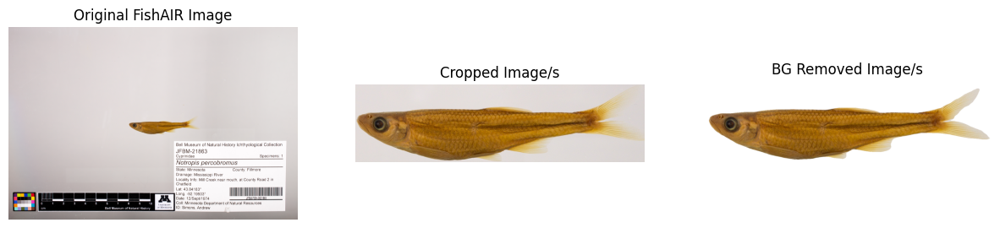

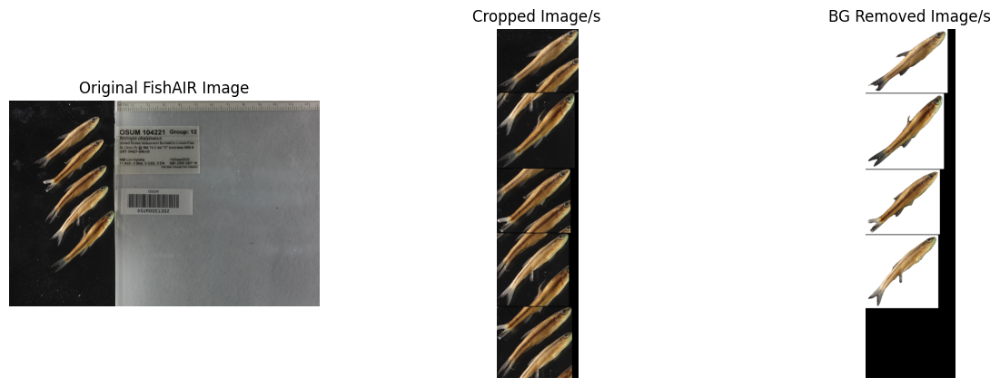

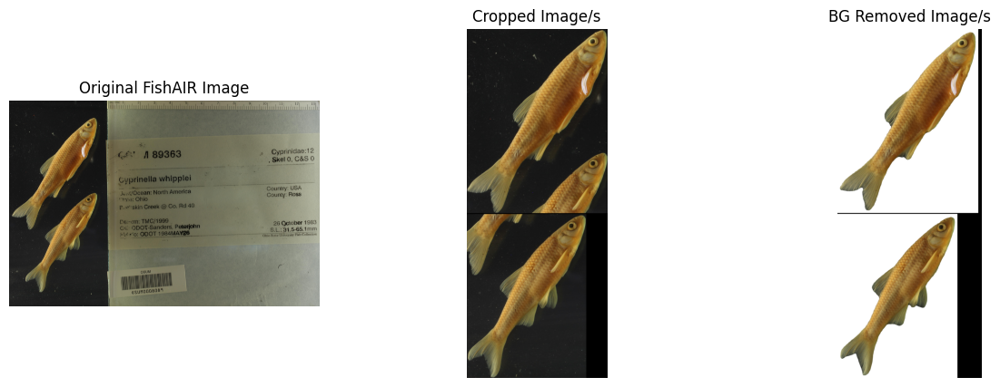

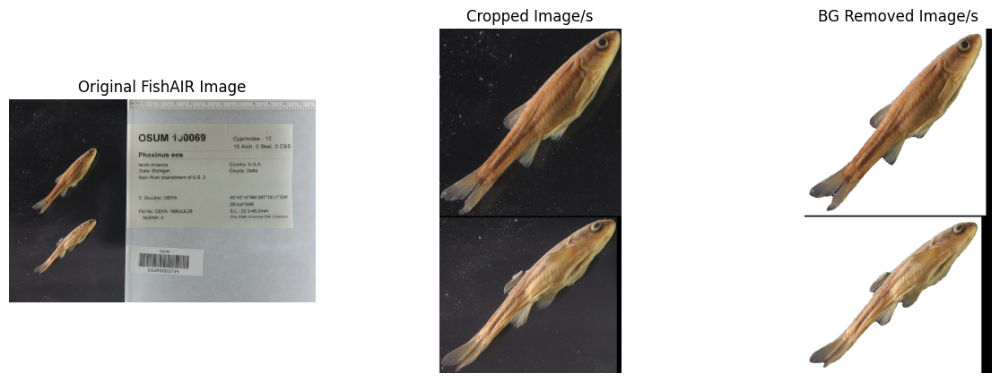

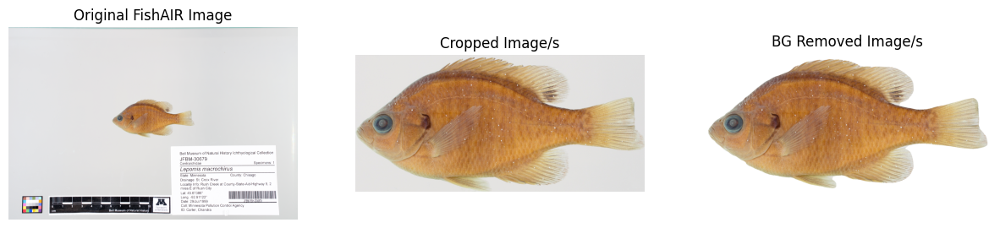

...

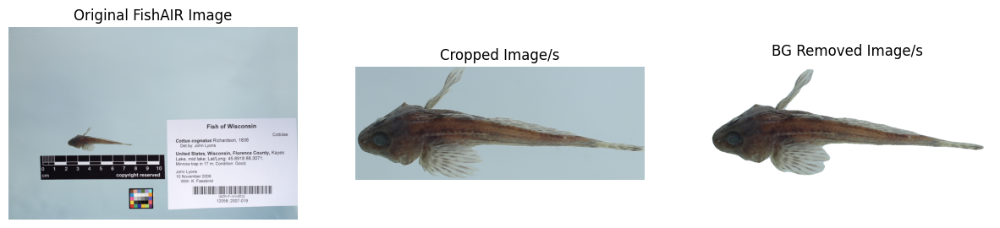

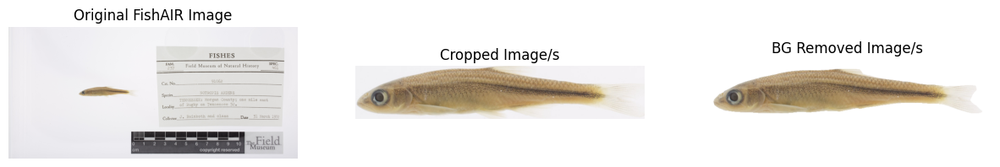

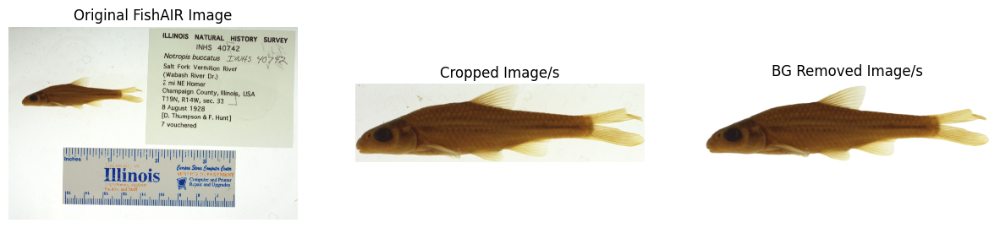

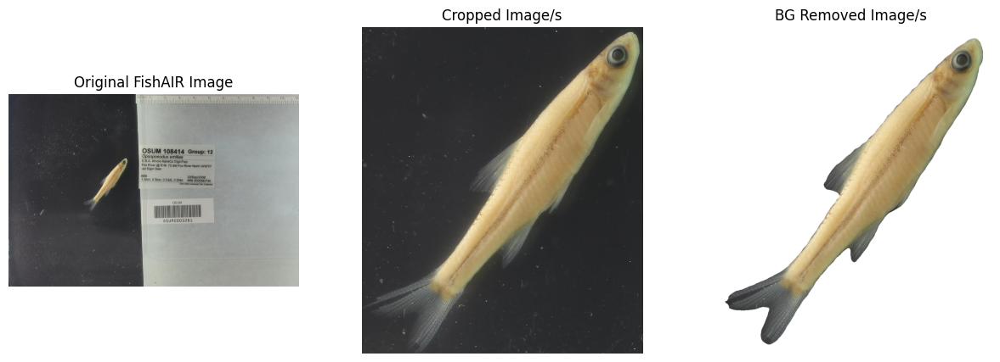

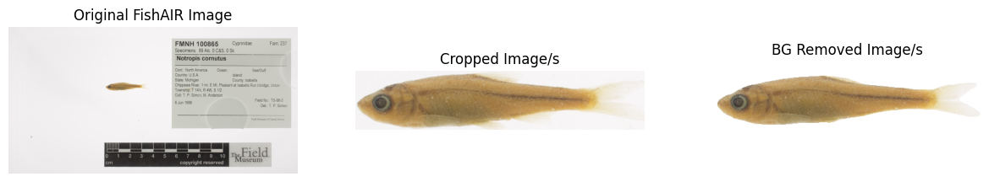

In [ ]:
process_and_display_images(glin_imgs[:100])

In [ ]:
process_and_display_images(glin_imgs[100:200])

In [ ]:
process_and_display_images(glin_imgs[200:300])

In [ ]:
process_and_display_images(glin_imgs[300:400])

In [ ]:
process_and_display_images(glin_imgs[400:500])

In [ ]:
process_and_display_images(glin_imgs[500:600])

In [ ]:
process_and_display_images(morphbank_imgs)

In [ ]:
process_and_display_images(idigbio_imgs)

In [1]:
# import pandas as pd
# import os

In [2]:
# df = pd.read_csv('classification_test.csv')

In [3]:
# df.owner.unique()

array(['JFBM', 'usnm', 'INHS', 'FMNH', 'mcz', 'nhmuk', 'UWZM', nan,
       'mnhn', 'cas', 'OSUM', 'uf', 'utep', 'uam', 'ypm', 'ucm'],
      dtype=object)

In [25]:
# def get_sampled_image_paths(df, column, value, n, img_dir):
#     img_names = list(df[df[column] == value].sample(n=n).arkid.unique())
#     img_names = [i + '.jpg' for i in img_names]
#     img_paths = [os.path.join(img_dir, i) for i in img_names]
#     return img_paths

In [39]:
# def get_sampled_image_paths_mb(df, column, value, n, img_dir):
#     img_names = list(df[df[column] == value].sample(n=n).source_filename.unique())
#     img_names = ['mb'+ i for i in img_names]
#     img_paths = [os.path.join(img_dir, i) for i in img_names]
#     return img_paths

In [36]:
# idigbio_imgs = get_sampled_image_paths(df, 'source', 'iDigBio', 100, '/projects/ml4science/FishAIR/Idigbio')

In [40]:
# morphbank_imgs = get_sampled_image_paths_mb(df, 'source', 'Morphbank', 100, '/projects/ml4science/FishAIR/Morphbank')